<a href="https://www.kaggle.com/code/mohamedshapan/breast-cancer-classification-using-ml?scriptVersionId=295763709" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# Breast Cancer Classification using Machine Learning

This notebook presents an end-to-end machine learning pipeline to classify breast cancer tumors as **malignant** or **benign** using the Breast Cancer Wisconsin dataset.

## Project Overview
- Data loading and exploration (EDA)
- Data preprocessing and feature scaling
- Training and evaluating multiple machine learning models
- Comparing models based on accuracy
- Using ensemble learning to improve performance

## Models Implemented
- Logistic Regression
- Support Vector Machine (SVM)
- Random Forest
- Voting Classifier

## Technologies Used
- Python
- NumPy & Pandas
- Scikit-learn
- Matplotlib & Seaborn

## Goal
Build a reliable and interpretable classification model that demonstrates practical machine learning skills and best practices.

Imports

In [1]:
import numpy as np 
import pandas as pd
import seaborn as sns 
import plotly.express as px
import matplotlib.pyplot as plt


from sklearn.datasets import load_breast_cancer
from sklearn.model_selection import train_test_split , GridSearchCV , StratifiedKFold
from sklearn.preprocessing import StandardScaler

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
#from sklearn.tree import DecisionTreeClassifier

from sklearn.ensemble import VotingClassifier
from sklearn.ensemble import RandomForestClassifier

#from sklearn.ensemble import AdaBoostClassifier
#from sklearn.ensemble import GradientBoostingClassifier
#from xgboost import XGBClassifier

from sklearn.metrics import accuracy_score

Load Dataset

In [2]:
data_load=load_breast_cancer()
data_load.keys()

dict_keys(['data', 'target', 'frame', 'target_names', 'DESCR', 'feature_names', 'filename', 'data_module'])

In [3]:
print('feature_names :',data_load.feature_names)
print('target_names :',data_load.target_names)
print('target :',data_load.target)


feature_names : ['mean radius' 'mean texture' 'mean perimeter' 'mean area'
 'mean smoothness' 'mean compactness' 'mean concavity'
 'mean concave points' 'mean symmetry' 'mean fractal dimension'
 'radius error' 'texture error' 'perimeter error' 'area error'
 'smoothness error' 'compactness error' 'concavity error'
 'concave points error' 'symmetry error' 'fractal dimension error'
 'worst radius' 'worst texture' 'worst perimeter' 'worst area'
 'worst smoothness' 'worst compactness' 'worst concavity'
 'worst concave points' 'worst symmetry' 'worst fractal dimension']
target_names : ['malignant' 'benign']
target : [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0
 1 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 1 1 1 1 0 1 1 0 1 1
 1 1 1 1 1 1 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1
 1 1 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 0 0 1 0
 1 0 1 

## Exploratory Data Analysis (EDA)


In [4]:
df_data=pd.DataFrame(data_load.data,columns=data_load.feature_names)
df_target=pd.DataFrame(data_load.target,columns=['label'])

data=pd.concat([df_data,df_target],axis=1)
data


,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,label
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,0
565,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,0
566,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,0
567,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,0


In [5]:
data.columns


Index(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error', 'fractal dimension error',
       'worst radius', 'worst texture', 'worst perimeter', 'worst area',
       'worst smoothness', 'worst compactness', 'worst concavity',
       'worst concave points', 'worst symmetry', 'worst fractal dimension',
       'label'],
      dtype='object')

In [6]:
data.shape

(569, 31)

In [7]:
data.isna().sum()

mean radius                0
mean texture               0
mean perimeter             0
mean area                  0
mean smoothness            0
mean compactness           0
mean concavity             0
mean concave points        0
mean symmetry              0
mean fractal dimension     0
radius error               0
texture error              0
perimeter error            0
area error                 0
smoothness error           0
compactness error          0
concavity error            0
concave points error       0
symmetry error             0
fractal dimension error    0
worst radius               0
worst texture              0
worst perimeter            0
worst area                 0
worst smoothness           0
worst compactness          0
worst concavity            0
worst concave points       0
worst symmetry             0
worst fractal dimension    0
label                      0
dtype: int64

In [8]:
data.duplicated().sum()

np.int64(0)

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   mean radius              569 non-null    float64
 1   mean texture             569 non-null    float64
 2   mean perimeter           569 non-null    float64
 3   mean area                569 non-null    float64
 4   mean smoothness          569 non-null    float64
 5   mean compactness         569 non-null    float64
 6   mean concavity           569 non-null    float64
 7   mean concave points      569 non-null    float64
 8   mean symmetry            569 non-null    float64
 9   mean fractal dimension   569 non-null    float64
 10  radius error             569 non-null    float64
 11  texture error            569 non-null    float64
 12  perimeter error          569 non-null    float64
 13  area error               569 non-null    float64
 14  smoothness error         5

In [10]:
data.describe()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,label
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,0.627417
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,0.483918
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,0.000000
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,0.000000
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,1.000000
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,1.000000
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,1.000000


In [11]:
data.label.value_counts(normalize=True).mul(100)

label
1    62.741652
0    37.258348
Name: proportion, dtype: float64

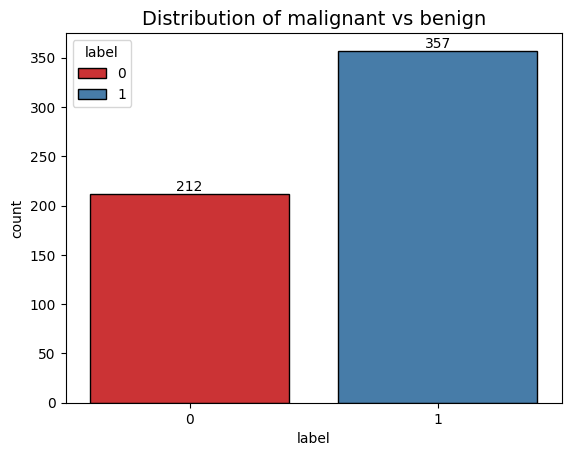

In [12]:
ax=sns.countplot(data=data,x='label',hue='label',edgecolor='black',palette='Set1')
for i in ax.containers:
  ax.bar_label(i)
plt.title('Distribution of malignant vs benign',fontsize=14)
plt.show()

In [13]:
for i in data.columns:# float
  if i != 'label':
    fig=px.histogram(data,data[i],title=i,color='label',pattern_shape='label',pattern_shape_map={0: '/',  1: '' },color_discrete_sequence=["#6BAED6", "#FC9272"])
    fig.show()

In [14]:
sns.pairplot(data)

In [15]:
sns.pairplot(data, hue='label', palette=['#6BAED6', '#FC9272'])

In [16]:
data.groupby('label').mean().T

label,0,1
mean radius,17.462830,12.146524
mean texture,21.604906,17.914762
mean perimeter,115.365377,78.075406
mean area,978.376415,462.790196
mean smoothness,0.102898,0.092478
mean compactness,0.145188,0.080085
mean concavity,0.160775,0.046058
mean concave points,0.087990,0.025717
mean symmetry,0.192909,0.174186
mean fractal dimension,0.062680,0.062867


In [17]:
data.groupby('label').median().T

label,0,1
mean radius,17.325000,12.200000
mean texture,21.460000,17.390000
mean perimeter,114.200000,78.180000
mean area,932.000000,458.400000
mean smoothness,0.102200,0.090760
mean compactness,0.132350,0.075290
mean concavity,0.151350,0.037090
mean concave points,0.086280,0.023440
mean symmetry,0.189900,0.171400
mean fractal dimension,0.061575,0.061540


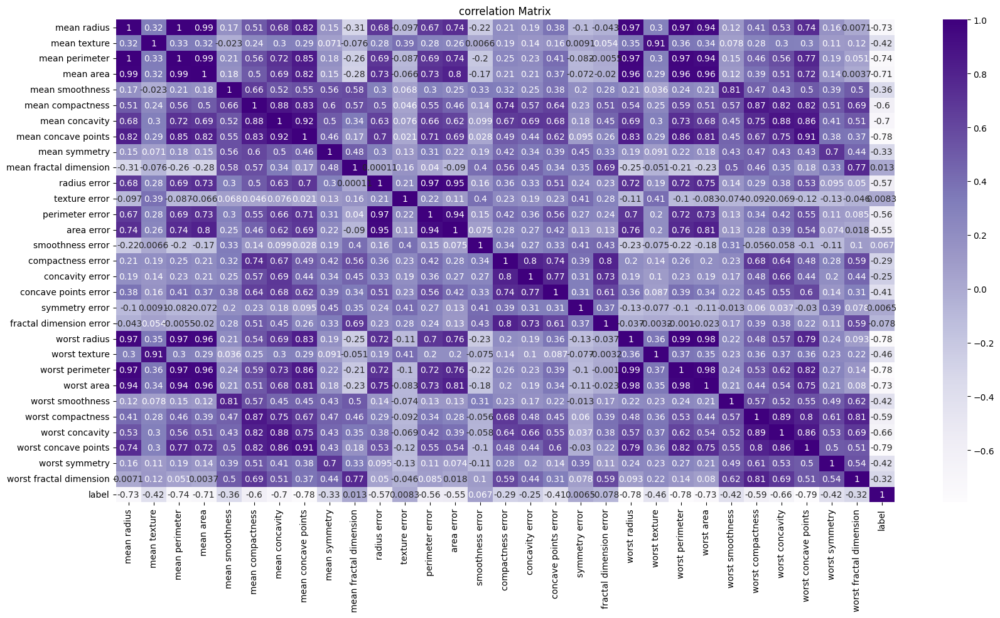

In [18]:
plt.figure(figsize=(20,10))
sns.heatmap(data.corr(),cmap='Purples',annot=True)
plt.title('correlation Matrix')
plt.show()

## Data Preprocessing

In [19]:
x=data.drop(columns='label',axis=1)
y=data.label

In [20]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=42)

In [21]:
scaler=StandardScaler()
x_train=scaler.fit_transform(x_train)
x_test=scaler.transform(x_test)

<Axes: >

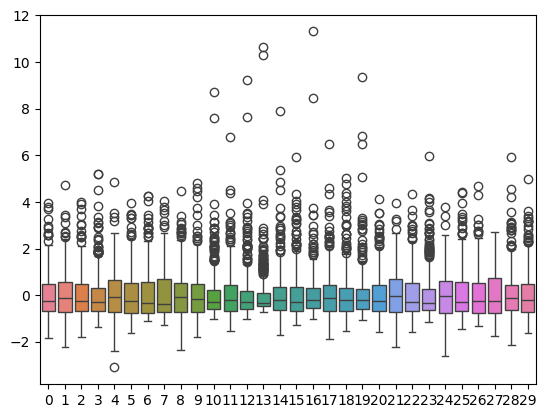

In [22]:
sns.boxplot(x_train)


In [23]:
svc=SVC(kernel='linear')
svc.fit(x_train,y_train)
print(svc.score(x_train,y_train))
print(svc.score(x_test,y_test))

0.9868131868131869
0.956140350877193


In [24]:
svc=SVC(kernel='rbf')
svc.fit(x_train,y_train)
print(svc.score(x_train,y_train))
print(svc.score(x_test,y_test))

0.989010989010989
0.9824561403508771


## Model Training (SVM)

In [25]:
svc = SVC(kernel='poly')
svc.fit(x_train,y_train)
print(svc.score(x_train,y_train))
print(svc.score(x_test,y_test))

0.9142857142857143
0.868421052631579


In [26]:
svc = SVC(kernel='poly', degree=3, C=3, gamma=0.1 , probability=True )
svc.fit(x_train,y_train)
print(svc.score(x_train,y_train))
print(svc.score(x_test,y_test))

0.9956043956043956
0.956140350877193


In [27]:
print("Overfitting gap:", svc.score(x_train,y_train) - svc.score(x_test,y_test))


Overfitting gap: 0.03946404472720266


In [28]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(
    SVC(kernel='rbf', C=1, gamma='scale'),
    x_train,
    y_train,
    cv=5
)

print("CV Accuracy:", scores.mean())


CV Accuracy: 0.9758241758241759


In [29]:
param_grid = {
    'C': [0.1, 1, 10],
    'gamma': [0.01, 0.1, 1],
    'kernel': ['rbf']
}

grid = GridSearchCV(
    SVC(),
    param_grid,
    cv=5,
    scoring='accuracy'
)

grid.fit(x_train, y_train)

print(grid.best_params_)
print(grid.best_score_)


{'C': 10, 'gamma': 0.01, 'kernel': 'rbf'}
0.9714285714285715


In [30]:
from sklearn.metrics import classification_report, confusion_matrix

y_pred = svc.predict(x_test)

print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))


[[39  4]
 [ 1 70]]
              precision    recall  f1-score   support

           0       0.97      0.91      0.94        43
           1       0.95      0.99      0.97        71

    accuracy                           0.96       114
   macro avg       0.96      0.95      0.95       114
weighted avg       0.96      0.96      0.96       114



In [31]:
voting = VotingClassifier(
    estimators=[
        ('lr', LogisticRegression(max_iter=1000)),
        ('svc', SVC(probability=True)),
        ('rf', RandomForestClassifier(n_estimators=200))
    ],
    voting='soft'
)

voting.fit(x_train, y_train)
print("Voting Test Accuracy:", voting.score(x_test, y_test))


Voting Test Accuracy: 0.9736842105263158


In [32]:
import joblib
joblib.dump(svc, "breast_cancer_svm_model.pkl")
joblib.dump(scaler, "scaler.pkl")


['scaler.pkl']